In [1]:
import numpy as np
import pandas as pd
import astropy as ap
import matplotlib.pyplot as plt
from pyvo import registry
from mocpy import MOC
from astropy.coordinates import SkyCoord
from ipyaladin import Aladin
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

In [2]:
import pandas as pd

def nm_to_cm1(df, wavelength_col, new_col='wave'):
    df[new_col] = 1e7 / df[wavelength_col]
    return df

def vacuum_to_air(wavelength_vac_nm):
    """
    Convierte lambda (vacío, nm) a lambda (aire) usando la fórmula de Edlén (1966).
    Ref: https://www.astro.uu.se/valdwiki/Air-to-vacuum%20conversion
    """
    s = 1e4 / wavelength_vac_nm  # wavenumber in 1/μm
    n = 1 + 0.00008336624212083 + 0.02408926869968 / (130.1065924522 - s**2) + 0.0001599740894897 / (38.92568793293 - s**2)
    return wavelength_vac_nm / n


In [3]:
peaks = pd.read_csv("./lineas_hierro.csv")

# Convertir de Ångstroms a nanómetros (1 Å = 0.1 nm)
peaks['lambda_nm'] = peaks['lambda'] * 0.1

# Ahora aplicar las conversiones usando lambda_nm
nm_to_cm1(peaks, "lambda_nm", new_col='wave_cm1')
peaks['lambda_air_nm'] = [vacuum_to_air(x) for x in peaks['lambda_nm']]

# También calcular wave_cm1 a partir de lambda_air para mayor precisión
peaks['wave_air_cm1'] = 1e7 / peaks['lambda_air_nm']

peaks.head()

,lambda,lambda_nm,wave_cm1,lambda_air_nm,wave_air_cm1
0,4060.8601,406.08601,24625.325064,406.072809,24626.125596
1,4068.4198,406.84198,24579.567723,406.828853,24580.360836
2,4080.9899,408.09899,24503.858733,408.085987,24504.639519
3,4086.1573,408.61573,24472.870880,408.602778,24473.646603
4,4088.2476,408.82476,24460.358027,408.811829,24461.131702


In [4]:
CATALOGUE = "J/A+A/587/A65"
catalogue_ivoid = f"ivo://CDS.VizieR/{CATALOGUE}"
voresource = registry.search(ivoid=catalogue_ivoid)[0]

In [5]:
tables = voresource.get_tables()
print(f"In this catalogue, we have {len(tables)} tables.")
for table_name, table in tables.items():
    print(f"{table_name}: {table.description}")

In this catalogue, we have 3 tables.
J/A+A/587/A65/tablea1: Absolute convective blueshift of FeI lines measured from the IAG atlas
J/A+A/587/A65/spnir: NIR atlas 1000-2300nm
J/A+A/587/A65/spvis: VIS atlas 405-1065nm


In [6]:
table_name = list(tables.keys())[2]

# execute a synchronous ADQL query
tap_service = voresource.get_service("tap")
variables = tap_service.search(f'''
                                        SELECT
                                            *
                                        FROM
                                            "{table_name}"
                                        ''')
variables

<DALResultsTable length=4057462>
 recno       Wave         nFlux         rFlux    
            cm**-1                               
 int32     float64       float64       float64   
------- ------------- -------------- ------------
      1 9387.21732524  1.00402281538 0.0131453425
    ...           ...            ...          ...
4057461 24700.0820376 0.911843224585  0.002246958
4057462 24700.0858041 0.913044617454 0.0021814581

In [7]:
waves = np.array(variables.getcolumn("Wave"))
fluxes = np.array(variables.getcolumn("nFlux"))

In [8]:
# Usar wave_air_cm1 que está en cm⁻¹ (igual que waves)
wave_array_cm1 = np.array(peaks["wave_air_cm1"])

# Verificar cuáles están en los datos
tolerancia_cm1 = 0.5  # tolerancia en cm⁻¹ (ajustable según resolución)

estan_en_datos = []
no_estan_en_datos = []

for i, punto in enumerate(wave_array_cm1):
    diferencias = np.abs(waves - punto)
    indice_min = np.argmin(diferencias)
    
    if diferencias[indice_min] <= tolerancia_cm1:
        estan_en_datos.append(indice_min)
    else:
        no_estan_en_datos.append((i, punto))

print(f"Total líneas de hierro: {len(wave_array_cm1)}")
print(f"Líneas encontradas en espectro: {len(estan_en_datos)}")
print(f"Líneas NO encontradas: {len(no_estan_en_datos)}")

# Mostrar rangos para verificación
print(f"\n--- RANGOS ESPECTRALES ---")
print(f"Atlas (waves): {waves.min():.1f} a {waves.max():.1f} cm⁻¹")
print(f"Líneas Fe (wave_air_cm1): {wave_array_cm1.min():.1f} a {wave_array_cm1.max():.1f} cm⁻¹")
print(f"\n--- EQUIVALENTE EN NM ---")
print(f"Atlas: {1e7/waves.max():.0f} a {1e7/waves.min():.0f} nm")
print(f"Líneas Fe: {peaks['lambda_air_nm'].min():.0f} a {peaks['lambda_air_nm'].max():.0f} nm")

# Si hay muchas no encontradas, mostrar algunas
if len(no_estan_en_datos) > 0:
    print(f"\n--- EJEMPLOS NO ENCONTRADOS ---")
    for i, punto in no_estan_en_datos[:5]:
        lambda_nm = peaks.loc[i, 'lambda_air_nm']
        print(f"Línea {i}: {lambda_nm:.1f} nm ({punto:.1f} cm⁻¹)")

Total líneas de hierro: 622
Líneas encontradas en espectro: 621
Líneas NO encontradas: 1

--- RANGOS ESPECTRALES ---
Atlas (waves): 9387.2 a 24700.1 cm⁻¹
Líneas Fe (wave_air_cm1): -3680.5 a 24626.1 cm⁻¹

--- EQUIVALENTE EN NM ---
Atlas: 405 a 1065 nm
Líneas Fe: -2717 a 1061 nm

--- EJEMPLOS NO ENCONTRADOS ---
Línea 552: -2717.0 nm (-3680.5 cm⁻¹)


In [9]:
if len(estan_en_datos) > 0:
    waves_inside = np.array([waves[x] for x in estan_en_datos])
    fluxes_inside = np.array([fluxes[x] for x in estan_en_datos])
    waves_inside_ind = np.array(estan_en_datos)
    
    print(f"\n--- LÍNEAS ENCONTRADAS ---")
    for i, idx in enumerate(estan_en_datos):
        wave_cm1 = waves[idx]
        wave_nm = 1e7 / wave_cm1
        flux = fluxes[idx]
        # Encontrar la línea correspondiente en peaks
        for j, row in peaks.iterrows():
            if abs(wave_cm1 - row['wave_air_cm1']) < tolerancia_cm1:
                print(f"Línea {j}: {row['lambda_air_nm']:.1f} nm - Flujo: {flux:.3f}")
                break
else:
    print("\n¡ADVERTENCIA: No se encontraron coincidencias!")
    waves_inside = np.array([])
    fluxes_inside = np.array([])
    waves_inside_ind = np.array([])


--- LÍNEAS ENCONTRADAS ---
Línea 0: 406.1 nm - Flujo: 1.025
Línea 1: 406.8 nm - Flujo: 0.984
Línea 2: 408.1 nm - Flujo: 0.844
Línea 3: 408.6 nm - Flujo: 0.977
Línea 4: 408.8 nm - Flujo: 0.986
Línea 5: 409.0 nm - Flujo: 0.974
Línea 6: 411.5 nm - Flujo: 1.006
Línea 7: 412.4 nm - Flujo: 1.030
Línea 8: 412.7 nm - Flujo: 0.928
Línea 9: 412.7 nm - Flujo: 0.916
Línea 10: 413.6 nm - Flujo: 0.681
Línea 11: 413.8 nm - Flujo: 0.913
Línea 12: 414.3 nm - Flujo: 0.895
Línea 13: 414.9 nm - Flujo: 0.765
Línea 14: 415.0 nm - Flujo: 0.635
Línea 15: 415.1 nm - Flujo: 0.957
Línea 16: 415.6 nm - Flujo: 0.670
Línea 17: 415.8 nm - Flujo: 0.884
Línea 18: 415.8 nm - Flujo: 0.265
Línea 19: 416.0 nm - Flujo: 0.959
Línea 20: 417.3 nm - Flujo: 0.917
Línea 21: 417.7 nm - Flujo: 0.898
Línea 22: 418.3 nm - Flujo: 0.717
Línea 23: 418.8 nm - Flujo: 0.585
Línea 24: 418.9 nm - Flujo: 0.477
Línea 25: 419.2 nm - Flujo: 0.541
Línea 26: 419.7 nm - Flujo: 0.948
Línea 27: 420.2 nm - Flujo: 0.621
Línea 28: 420.4 nm - Flujo: 0.

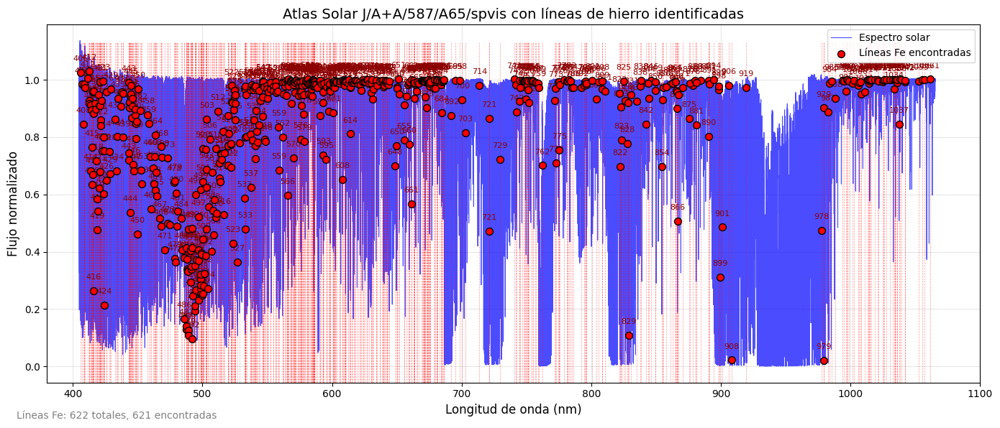

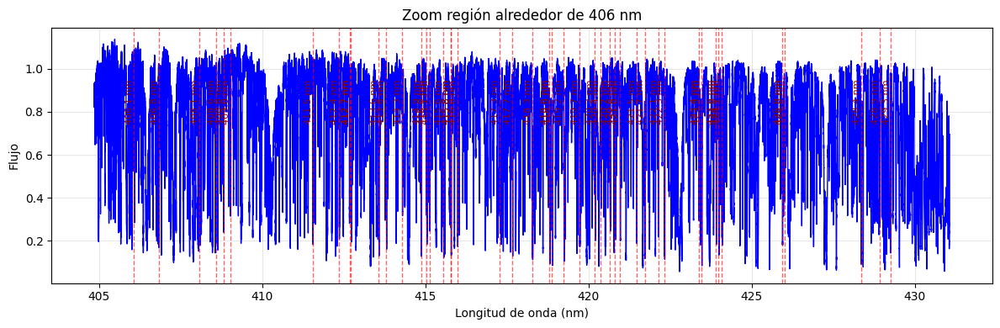

In [10]:
import matplotlib.pyplot as plt

# Convertir waves a nm para graficar
waves_nm = 1e7 / waves

plt.figure(figsize=(14, 6))

# 1. Graficar espectro completo
plt.plot(waves_nm, fluxes, 'b-', alpha=0.7, linewidth=0.8, label='Espectro solar')

# 2. Marcar todas las líneas de hierro como líneas verticales
for idx, row in peaks.iterrows():
    plt.axvline(x=row['lambda_air_nm'], color='red', linestyle='--', 
                alpha=0.4, linewidth=0.5, ymax=0.95)

# 3. Resaltar las líneas encontradas
if len(estan_en_datos) > 0:
    waves_inside_nm = 1e7 / waves_inside
    plt.scatter(waves_inside_nm, fluxes_inside, color='red', s=50, 
                edgecolors='black', zorder=5, label='Líneas Fe encontradas')
    
    # Añadir etiquetas a las líneas encontradas
    for i, (wave_nm, flux) in enumerate(zip(waves_inside_nm, fluxes_inside)):
        plt.annotate(f'{wave_nm:.0f}', 
                    xy=(wave_nm, flux), 
                    xytext=(0, 10),
                    textcoords='offset points',
                    ha='center', va='bottom',
                    fontsize=8, color='darkred')

# Configuración del gráfico
plt.xlabel('Longitud de onda (nm)', fontsize=12)
plt.ylabel('Flujo normalizado', fontsize=12)
plt.title(f'Atlas Solar {table_name} con líneas de hierro identificadas', fontsize=14)

# Ajustar límites según el atlas que estés usando
if "spvis" in table_name:  # Atlas visible
    plt.xlim(380, 1100)
elif "spnir" in table_name:  # Atlas infrarrojo cercano
    plt.xlim(900, 2500)

plt.legend(loc='upper right')
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Añadir información en el gráfico
info_text = f'Líneas Fe: {len(peaks)} totales, {len(estan_en_datos)} encontradas'
plt.figtext(0.02, 0.02, info_text, fontsize=10, color='gray')

plt.show()

# Gráfico de zoom para ver detalles
if len(estan_en_datos) > 0:
    plt.figure(figsize=(12, 4))
    
    # Seleccionar una región con líneas encontradas
    if len(waves_inside_nm) > 0:
        region_center = waves_inside_nm[0]
        region_width = 50  # nm
        
        # Filtrar datos en la región
        mask = (waves_nm >= region_center - region_width/2) & (waves_nm <= region_center + region_width/2)
        
        if np.any(mask):
            plt.plot(waves_nm[mask], fluxes[mask], 'b-', linewidth=1)
            
            # Marcar líneas en esta región
            for idx, row in peaks.iterrows():
                if abs(row['lambda_air_nm'] - region_center) < region_width/2:
                    plt.axvline(x=row['lambda_air_nm'], color='red', linestyle='--', 
                                alpha=0.6, linewidth=1)
                    plt.annotate(f'{row["lambda_air_nm"]:.1f} nm', 
                                xy=(row['lambda_air_nm'], 0.95),
                                rotation=90, fontsize=8, color='darkred',
                                ha='right', va='top')
            
            plt.xlabel('Longitud de onda (nm)')
            plt.ylabel('Flujo')
            plt.title(f'Zoom región alrededor de {region_center:.0f} nm')
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            plt.show()

In [11]:
# Versión más eficiente usando list comprehensions
waves_ranges = []
fluxes_ranges = []

for idx in estan_en_datos:
    start = max(0, idx - 10)
    end = min(len(waves), idx + 11)
    waves_ranges.append(waves[start:end])
    fluxes_ranges.append(fluxes[start:end])

# Graficar solo algunos ejemplos (primeros 5)
num_to_plot = min(622, len(waves_ranges))
fig, axes = plt.subplots(num_to_plot, 1, figsize=(12, 4*num_to_plot))

if num_to_plot == 1:
    axes = [axes]

for i, (ax, wave_range, flux_range) in enumerate(zip(axes, waves_ranges[:num_to_plot], fluxes_ranges[:num_to_plot])):
    ax.plot(wave_range, flux_range, 'b-', linewidth=1.5)
    
    # Marcar el punto central
    center_idx = len(wave_range) // 2
    ax.scatter(wave_range[center_idx], flux_range[center_idx], 
               color='red', s=80, zorder=5, edgecolors='black')
    
    ax.set_xlabel('Wavelength', fontsize=11)
    ax.set_ylabel('Flux', fontsize=11)
    ax.set_title(f'Punto {i+1}: Índice original {estan_en_datos[i]}', fontsize=12)
    ax.grid(True, alpha=0.3)
    ax.axvline(x=wave_range[center_idx], color='r', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

Procesando 621 puntos...
Búsqueda de mínimos locales completada


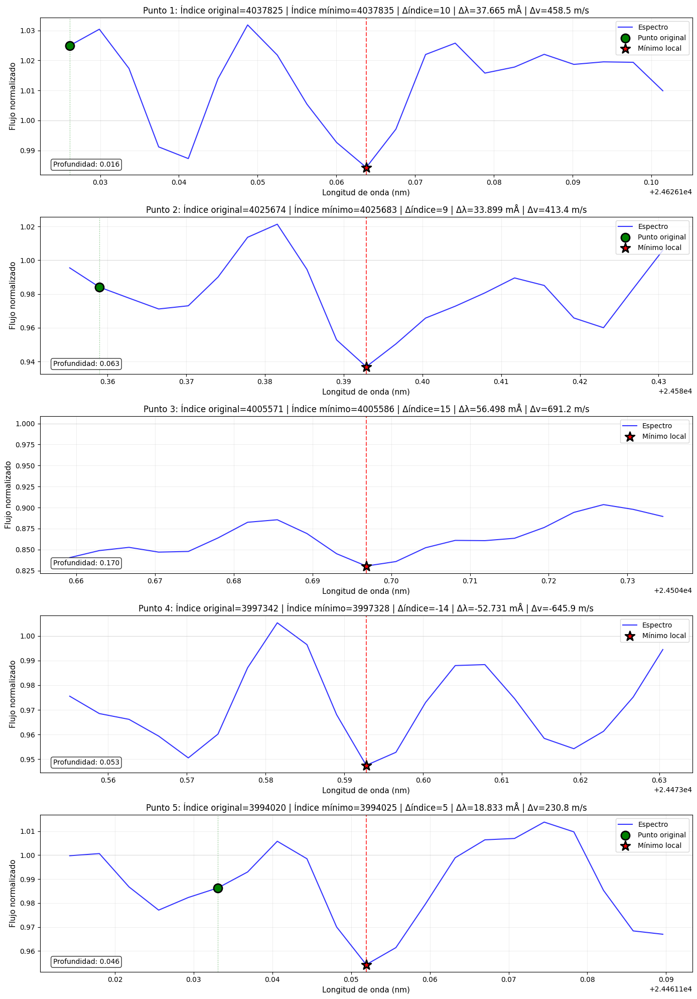


RESUMEN DE TODOS LOS PUNTOS ANALIZADOS
#   Idx_orig Idx_min  Δidx   λ_orig       λ_min        Δλ(mÅ)     Flux_orig  Flux_min   Prof.
----------------------------------------------------------------------------------------------------
1   4037825  4037835  10     24626.12613  24626.16380  37.665     1.025      0.984      0.016
2   4025674  4025683  9      24580.35897  24580.39287  33.899     0.984      0.937      0.063
3   4005571  4005586  15     24504.64033  24504.69683  56.498     0.844      0.830      0.170
4   3997342  3997328  -14    24473.64552  24473.59279  -52.731    0.977      0.947      0.053
5   3994020  3994025  5      24461.13309  24461.15192  18.833     0.986      0.954      0.046
6   3990648  3990658  10     24448.43234  24448.47000  37.665     0.974      0.967      0.033
7   3950843  3950850  7      24298.50543  24298.53180  26.366     1.006      0.973      0.027
8   3938212  3938214  2      24250.93034  24250.93787  7.533      1.030      0.997      0.003
9   3932961  

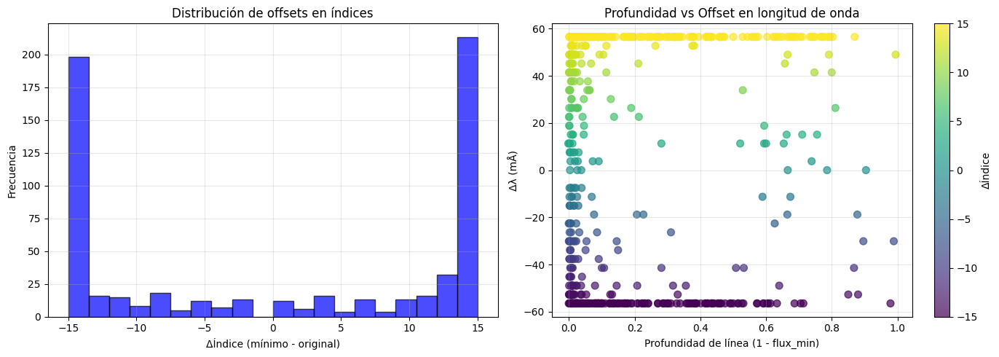


Análisis completado:
• Número total de puntos procesados: 621
• Rango medio de offsets en índice: 12.57 ± 13.18
• Rango medio de offsets en λ: 47.364 ± 49.659 mÅ
• Profundidad media de líneas: 0.178 ± 0.239


In [12]:


def find_local_minima_around_point(waves, fluxes, center_idx, search_radius=15, smooth_sigma=1):
    """
    Encuentra el mínimo local más cercano a un punto dado.
    
    Parameters:
    -----------
    waves : array
        Array de longitudes de onda
    fluxes : array
        Array de flujos normalizados
    center_idx : int
        Índice del punto central original
    search_radius : int
        Radio de búsqueda en puntos alrededor del centro
    smooth_sigma : float
        Parámetro de suavizado Gaussiano para eliminar ruido
        
    Returns:
    --------
    min_idx : int
        Índice del mínimo local encontrado
    min_flux : float
        Valor de flujo en el mínimo
    min_wave : float
        Longitud de onda del mínimo
    """
    # Definir límites de búsqueda
    start_idx = max(0, center_idx - search_radius)
    end_idx = min(len(waves), center_idx + search_radius + 1)
    
    # Extraer región de búsqueda
    search_waves = waves[start_idx:end_idx]
    search_fluxes = fluxes[start_idx:end_idx]
    
    # Suavizar ligeramente para eliminar ruido y encontrar mínimos reales
    if len(search_fluxes) > 5:
        smoothed_fluxes = gaussian_filter1d(search_fluxes, sigma=smooth_sigma)
    else:
        smoothed_fluxes = search_fluxes
    
    # Invertir flujo para buscar máximos (find_peaks busca máximos)
    # En flujo invertido, los mínimos se convierten en máximos
    inverted_flux = 1.0 - smoothed_fluxes
    
    # Buscar picos en el flujo invertido
    peaks, properties = find_peaks(
        inverted_flux,
        height=0.1,        # Profundidad mínima (10% de absorción)
        prominence=0.05,   # Prominencia mínima
        distance=3,        # Distancia mínima entre picos
        width=1           # Ancho mínimo
    )
    
    # Si encontramos picos (mínimos en el flujo original)
    if len(peaks) > 0:
        # Calcular distancias desde el centro original (en índice local)
        local_center_idx = center_idx - start_idx
        distances = np.abs(peaks - local_center_idx)
        
        # Tomar el mínimo más cercano
        nearest_min_idx_local = peaks[np.argmin(distances)]
        
        # Convertir a índice global
        min_idx = start_idx + nearest_min_idx_local
    else:
        # Si no encontramos mínimos, usar el punto con flujo más bajo
        min_idx_local = np.argmin(search_fluxes)
        min_idx = start_idx + min_idx_local
    
    return min_idx, fluxes[min_idx], waves[min_idx]

# Versión optimizada usando list comprehensions y búsqueda de mínimos locales
waves_ranges = []
fluxes_ranges = []
original_points = []
local_min_points = []

print(f"Procesando {len(estan_en_datos)} puntos...")

for idx in estan_en_datos:
    # Encontrar mínimo local más cercano
    min_idx, min_flux, min_wave = find_local_minima_around_point(
        waves, fluxes, idx, search_radius=15, smooth_sigma=1
    )
    
    # Definir rango de trazado alrededor del mínimo (no del punto original)
    plot_radius = 10  # Puntos a cada lado del mínimo
    start = max(0, min_idx - plot_radius)
    end = min(len(waves), min_idx + plot_radius + 1)
    
    waves_ranges.append(waves[start:end])
    fluxes_ranges.append(fluxes[start:end])
    original_points.append((idx, waves[idx], fluxes[idx]))
    local_min_points.append((min_idx, min_wave, min_flux))

print("Búsqueda de mínimos locales completada")

# Crear gráficas
num_to_plot = min(5, len(waves_ranges))  # Mostrar solo primeros 5 para visualización
fig, axes = plt.subplots(num_to_plot, 1, figsize=(14, 4*num_to_plot), sharex=False)

if num_to_plot == 1:
    axes = [axes]

for i, (ax, wave_range, flux_range, orig_pt, min_pt) in enumerate(zip(
    axes, waves_ranges[:num_to_plot], fluxes_ranges[:num_to_plot],
    original_points[:num_to_plot], local_min_points[:num_to_plot]
)):
    # Trazar el espectro
    ax.plot(wave_range, flux_range, 'b-', linewidth=1.5, alpha=0.8, label='Espectro')
    
    # Marcar el punto original (verde)
    orig_idx, orig_wave, orig_flux = orig_pt
    # Verificar si el punto original está dentro del rango trazado
    if wave_range[0] <= orig_wave <= wave_range[-1]:
        ax.scatter(orig_wave, orig_flux, 
                  color='green', s=150, zorder=10, edgecolors='black', linewidth=2,
                  marker='o', label='Punto original')
        ax.axvline(x=orig_wave, color='green', linestyle=':', alpha=0.5, linewidth=1)
    
    # Marcar el mínimo local encontrado (rojo)
    min_idx, min_wave, min_flux = min_pt
    ax.scatter(min_wave, min_flux, 
              color='red', s=200, zorder=10, edgecolors='black', linewidth=2,
              marker='*', label='Mínimo local')
    ax.axvline(x=min_wave, color='red', linestyle='--', alpha=0.7, linewidth=1.5)
    
    # Añadir línea de continuo (flujo=1)
    ax.axhline(y=1.0, color='gray', linestyle='-', alpha=0.3, linewidth=0.5)
    
    # Calcular y mostrar métricas
    offset_pixels = min_idx - orig_idx
    offset_wave = min_wave - orig_wave
    
    # Calcular offset en velocidad (m/s)
    c = 299792458  # m/s
    if orig_wave > 0:
        velocity_offset = (offset_wave / orig_wave) * c
        velocity_text = f'{velocity_offset:.1f} m/s'
    else:
        velocity_offset = 0
        velocity_text = 'N/A'
    
    # Información en el título
    ax.set_title(
        f'Punto {i+1}: Índice original={orig_idx} | '
        f'Índice mínimo={min_idx} | Δíndice={offset_pixels} | '
        f'Δλ={offset_wave*1000:.3f} mÅ | Δv={velocity_text}',
        fontsize=12
    )
    
    ax.set_xlabel('Longitud de onda (nm)', fontsize=11)
    ax.set_ylabel('Flujo normalizado', fontsize=11)
    ax.grid(True, alpha=0.2)
    ax.legend(loc='upper right')
    
    # Añadir anotación con profundidad de línea
    line_depth = 1 - min_flux
    ax.annotate(f'Profundidad: {line_depth:.3f}', 
                xy=(0.02, 0.05), xycoords='axes fraction',
                fontsize=10, bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

plt.tight_layout()
plt.show()

# Mostrar resumen de todos los puntos
print("\n" + "="*80)
print("RESUMEN DE TODOS LOS PUNTOS ANALIZADOS")
print("="*80)
print(f"{'#':<3} {'Idx_orig':<8} {'Idx_min':<8} {'Δidx':<6} {'λ_orig':<12} {'λ_min':<12} {'Δλ(mÅ)':<10} {'Flux_orig':<10} {'Flux_min':<10} {'Prof.'}")
print("-"*100)

for i in range(len(original_points)):
    orig_idx, orig_wave, orig_flux = original_points[i]
    min_idx, min_wave, min_flux = local_min_points[i]
    
    offset_idx = min_idx - orig_idx
    offset_wave_mA = (min_wave - orig_wave) * 1000  # en mÅ
    depth = 1 - min_flux
    
    print(f"{i+1:<3} {orig_idx:<8} {min_idx:<8} {offset_idx:<6} "
          f"{orig_wave:<12.5f} {min_wave:<12.5f} {offset_wave_mA:<10.3f} "
          f"{orig_flux:<10.3f} {min_flux:<10.3f} {depth:.3f}")

# Crear gráfica de resumen de offsets
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Histograma de offsets en píxeles
offsets_idx = [min_pt[0] - orig_pt[0] for orig_pt, min_pt in zip(original_points, local_min_points)]
ax1.hist(offsets_idx, bins=20, alpha=0.7, color='blue', edgecolor='black')
ax1.set_xlabel('ΔÍndice (mínimo - original)')
ax1.set_ylabel('Frecuencia')
ax1.set_title('Distribución de offsets en índices')
ax1.grid(True, alpha=0.3)

# Gráfica de dispersión: profundidad vs offset
depths = [1 - min_pt[2] for min_pt in local_min_points]
offsets_wave = [(min_pt[1] - orig_pt[1])*1000 for orig_pt, min_pt in zip(original_points, local_min_points)]

scatter = ax2.scatter(depths, offsets_wave, c=offsets_idx, cmap='viridis', alpha=0.7, s=50)
ax2.set_xlabel('Profundidad de línea (1 - flux_min)')
ax2.set_ylabel('Δλ (mÅ)')
ax2.set_title('Profundidad vs Offset en longitud de onda')
ax2.grid(True, alpha=0.3)

# Añadir barra de color para offsets en índices
cbar = plt.colorbar(scatter, ax=ax2)
cbar.set_label('ΔÍndice')

plt.tight_layout()
plt.show()

print(f"\nAnálisis completado:")
print(f"• Número total de puntos procesados: {len(estan_en_datos)}")
print(f"• Rango medio de offsets en índice: {np.mean(np.abs(offsets_idx)):.2f} ± {np.std(offsets_idx):.2f}")
print(f"• Rango medio de offsets en λ: {np.mean(np.abs(offsets_wave)):.3f} ± {np.std(offsets_wave):.3f} mÅ")
print(f"• Profundidad media de líneas: {np.mean(depths):.3f} ± {np.std(depths):.3f}")

In [13]:
local_min_points

[(np.int64(4037835), np.float64(24626.1637987), np.float64(0.984341391232)),
 (np.int64(4025683), np.float64(24580.3928718), np.float64(0.936922127486)),
 (np.int64(4005586), np.float64(24504.6968286), np.float64(0.830468719482)),
 (np.int64(3997328), np.float64(24473.592787), np.float64(0.947493716413)),
 (np.int64(3994025), np.float64(24461.1519236), np.float64(0.95430869337)),
 (np.int64(3990658), np.float64(24448.4700021), np.float64(0.967040272478)),
 (np.int64(3950850), np.float64(24298.531798), np.float64(0.972564590578)),
 (np.int64(3938214), np.float64(24250.9378685), np.float64(0.996660443942)),
 (np.int64(3932974), np.float64(24231.2012278), np.float64(0.895313799888)),
 (np.int64(3932476), np.float64(24229.3254937), np.float64(0.87424130093)),
 (np.int64(3919286), np.float64(24179.644904), np.float64(0.654824352201)),
 (np.int64(3915656), np.float64(24165.9723839), np.float64(0.889460401841)),
 (np.int64(3908141), np.float64(24137.6668774), np.float64(0.872606702057)),
 (np

Líneas encontradas en el espectro: 621
RESULTADOS DE ANCHO EQUIVALENTE (EW)
Número de líneas analizadas: 621

Primeras 10 líneas:
   indice_peak  lambda_air_nm  wave_air_cm1  EW_nm_fixed  EW_nm_auto
0            0     406.072809  24626.125596     0.252641    0.000000
1            1     406.828853  24580.360836     0.280360    0.000006
2            2     408.085987  24504.639519     0.247990    0.009330
3            3     408.602778  24473.646603     0.148015    0.000005
4            4     408.811829  24461.131702     0.147028    0.000004
5            5     409.024211  24448.430526     0.123676    0.000005
6            6     411.547939  24298.505826     0.155215    0.000000
7            7     412.355284  24250.932130     0.171041    0.000000
8            8     412.691899  24231.151660     0.180154    0.015252
9            9     412.722132  24229.376652     0.182318    0.010241

ESTADÍSTICAS DE EW (método ancho fijo)
EW medio: 0.083108 nm
EW máximo: 0.442762 nm
EW mínimo: 0.001250 nm
Des

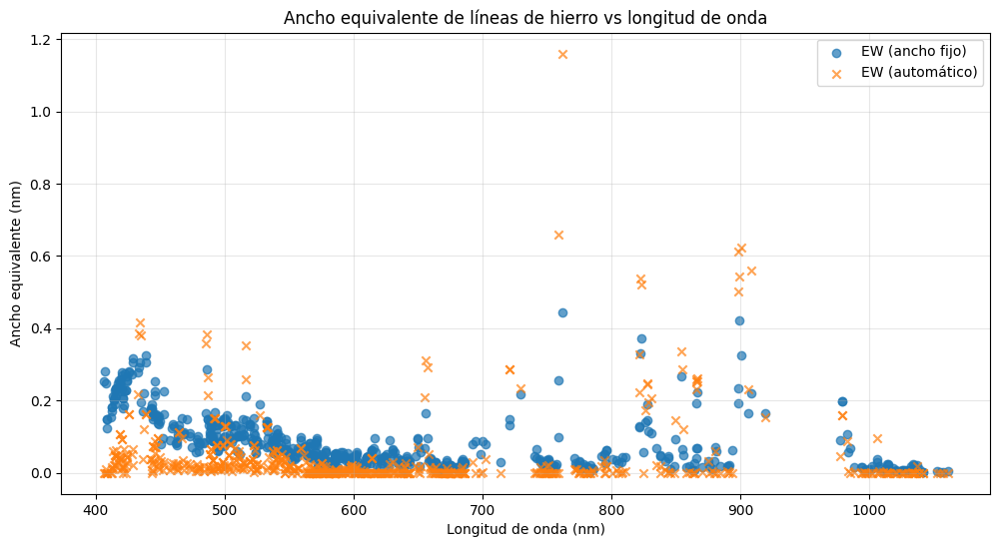

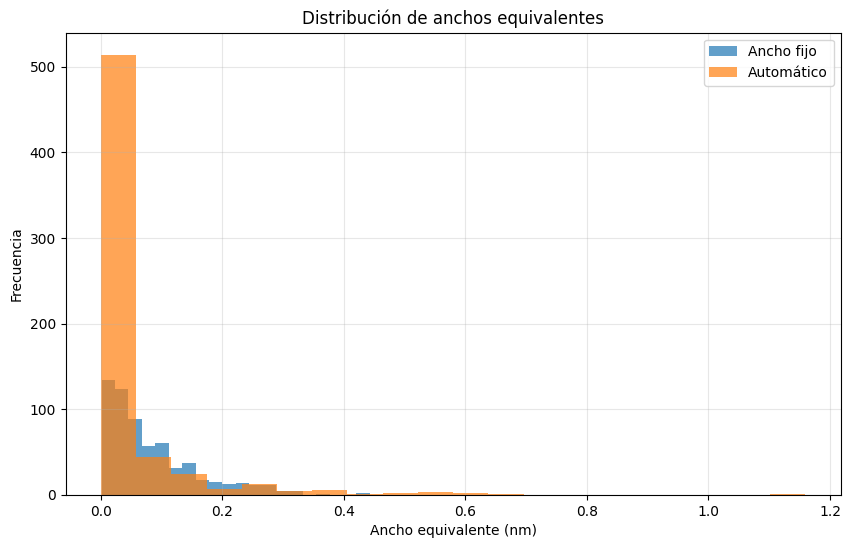


Resultados guardados en 'resultados_ew_lineas_hierro.csv'
Resumen guardado en 'resumen_ew.csv'


In [14]:
import numpy as np
import pandas as pd

# --------------------------------------------------------------------
# 1. PREPARAR EL ESPECTRO: convertir a nm y ordenar
# --------------------------------------------------------------------
# Convertir waves (cm⁻¹) a lambda (nm) y ordenar
lambda_nm_spectrum = 1e7 / waves  # Convertir a nm
sort_idx = np.argsort(lambda_nm_spectrum)
lambda_nm_spectrum = lambda_nm_spectrum[sort_idx]
flux_spectrum = fluxes[sort_idx]

# --------------------------------------------------------------------
# 2. IDENTIFICAR LAS LÍNEAS EN EL ESPECTRO (CORREGIDO)
# --------------------------------------------------------------------
# Primero necesitamos encontrar qué líneas de peaks coinciden con el espectro
wave_array_cm1 = np.array(peaks["wave_air_cm1"])
tolerancia_cm1 = 0.5  # tolerancia en cm⁻¹

# Lista para almacenar los índices de las líneas en peaks que coinciden
lineas_encontradas_indices = []
lineas_encontradas_lambda = []
lineas_encontradas_wave_cm1 = []

for i, (lambda_nm, wave_cm1) in enumerate(zip(peaks['lambda_air_nm'], peaks['wave_air_cm1'])):
    # Buscar el punto más cercano en el espectro
    idx_cercano = np.argmin(np.abs(lambda_nm_spectrum - lambda_nm))
    lambda_cercano = lambda_nm_spectrum[idx_cercano]
    
    # Verificar si está dentro de la tolerancia
    if abs(lambda_cercano - lambda_nm) <= (1e7/(wave_cm1**2) * tolerancia_cm1):  # Convertir tolerancia a nm
        lineas_encontradas_indices.append(i)
        lineas_encontradas_lambda.append(lambda_nm)
        lineas_encontradas_wave_cm1.append(wave_cm1)

print(f"Líneas encontradas en el espectro: {len(lineas_encontradas_indices)}")

# --------------------------------------------------------------------
# 3. DEFINIR FUNCIONES PARA CALCULAR ANCHO EQUIVALENTE (EW)
# --------------------------------------------------------------------
# Método 1: Ancho fijo centrado en la línea
def calcular_ew_fixed_width(lambda_centro, lambda_nm_spectrum, flux_spectrum, ancho=1.0):
    """
    Calcula el ancho equivalente para una línea centrada en lambda_centro (nm).
    ancho: ancho total del intervalo en nm (centrado en lambda_centro).
    """
    lambda_min = lambda_centro - ancho/2
    lambda_max = lambda_centro + ancho/2

    idx = np.where((lambda_nm_spectrum >= lambda_min) & (lambda_nm_spectrum <= lambda_max))[0]
    if len(idx) < 2:
        return 0.0

    lambda_interval = lambda_nm_spectrum[idx]
    flux_interval = flux_spectrum[idx]

    # Ordenar (por si acaso)
    sort_idx_local = np.argsort(lambda_interval)
    lambda_interval = lambda_interval[sort_idx_local]
    flux_interval = flux_interval[sort_idx_local]

    # Integración trapezoidal
    ew = 0.0
    for i in range(len(lambda_interval)-1):
        dlambda = lambda_interval[i+1] - lambda_interval[i]
        ew += ((1 - flux_interval[i]) + (1 - flux_interval[i+1])) / 2 * dlambda

    return ew

# Método 2: Detección automática de bordes
def calcular_ew_auto(lambda_centro, lambda_nm_spectrum, flux_spectrum, umbral=0.99, max_ancho=2.0):
    """
    Calcula el ancho equivalente detectando automáticamente los bordes de la línea.
    umbral: flujo al que se considera que termina la línea (ej. 0.99).
    max_ancho: ancho máximo permitido para buscar (nm).
    """
    # Encontrar índice más cercano al centro
    idx_centro = np.argmin(np.abs(lambda_nm_spectrum - lambda_centro))
    lambda_centro_real = lambda_nm_spectrum[idx_centro]

    # Mover hacia la izquierda hasta alcanzar el umbral o el ancho máximo
    idx_left = idx_centro
    while idx_left > 0 and (lambda_centro_real - lambda_nm_spectrum[idx_left]) < max_ancho/2:
        if flux_spectrum[idx_left] >= umbral:
            break
        idx_left -= 1

    # Mover hacia la derecha
    idx_right = idx_centro
    while idx_right < len(lambda_nm_spectrum)-1 and (lambda_nm_spectrum[idx_right] - lambda_centro_real) < max_ancho/2:
        if flux_spectrum[idx_right] >= umbral:
            break
        idx_right += 1

    if idx_right - idx_left < 1:
        return 0.0

    # Extraer intervalo
    lambda_interval = lambda_nm_spectrum[idx_left:idx_right+1]
    flux_interval = flux_spectrum[idx_left:idx_right+1]

    # Ordenar
    sort_idx_local = np.argsort(lambda_interval)
    lambda_interval = lambda_interval[sort_idx_local]
    flux_interval = flux_interval[sort_idx_local]

    # Integración trapezoidal
    ew = 0.0
    for i in range(len(lambda_interval)-1):
        dlambda = lambda_interval[i+1] - lambda_interval[i]
        ew += ((1 - flux_interval[i]) + (1 - flux_interval[i+1])) / 2 * dlambda

    return ew

# --------------------------------------------------------------------
# 4. CALCULAR EW PARA CADA LÍNEA ENCONTRADA
# --------------------------------------------------------------------
# Calcular EW para cada línea (usando ancho fijo de 1.0 nm)
ews_fixed = []
ews_auto = []

for i, lambda_centro in enumerate(lineas_encontradas_lambda):
    # Método ancho fijo
    ew_fixed = calcular_ew_fixed_width(lambda_centro, lambda_nm_spectrum, flux_spectrum, ancho=1.0)
    ews_fixed.append(ew_fixed)
    
    # Método automático
    ew_auto = calcular_ew_auto(lambda_centro, lambda_nm_spectrum, flux_spectrum, umbral=0.99, max_ancho=2.0)
    ews_auto.append(ew_auto)

# --------------------------------------------------------------------
# 5. CREAR DATAFRAME CON RESULTADOS
# --------------------------------------------------------------------
resultados_ew = pd.DataFrame({
    'indice_peak': lineas_encontradas_indices,
    'lambda_air_nm': lineas_encontradas_lambda,
    'wave_air_cm1': lineas_encontradas_wave_cm1,
    'EW_nm_fixed': ews_fixed,
    'EW_nm_auto': ews_auto
})

# Mostrar resultados
print("="*60)
print("RESULTADOS DE ANCHO EQUIVALENTE (EW)")
print("="*60)
print(f"Número de líneas analizadas: {len(resultados_ew)}")
print("\nPrimeras 10 líneas:")
print(resultados_ew.head(10))

# --------------------------------------------------------------------
# 6. ESTADÍSTICAS BÁSICAS
# --------------------------------------------------------------------
print("\n" + "="*60)
print("ESTADÍSTICAS DE EW (método ancho fijo)")
print("="*60)
print(f"EW medio: {resultados_ew['EW_nm_fixed'].mean():.6f} nm")
print(f"EW máximo: {resultados_ew['EW_nm_fixed'].max():.6f} nm")
print(f"EW mínimo: {resultados_ew['EW_nm_fixed'].min():.6f} nm")
print(f"Desviación estándar: {resultados_ew['EW_nm_fixed'].std():.6f} nm")

# Comparación de métodos
print("\n" + "="*60)
print("COMPARACIÓN DE MÉTODOS")
print("="*60)
print(f"Correlación entre métodos: {resultados_ew['EW_nm_fixed'].corr(resultados_ew['EW_nm_auto']):.4f}")
print(f"Diferencia media: {(resultados_ew['EW_nm_fixed'] - resultados_ew['EW_nm_auto']).abs().mean():.6f} nm")

# --------------------------------------------------------------------
# 7. VISUALIZACIÓN (opcional)
# --------------------------------------------------------------------
import matplotlib.pyplot as plt

# Graficar EW vs longitud de onda
plt.figure(figsize=(12, 6))
plt.scatter(resultados_ew['lambda_air_nm'], resultados_ew['EW_nm_fixed'], alpha=0.7, label='EW (ancho fijo)')
plt.scatter(resultados_ew['lambda_air_nm'], resultados_ew['EW_nm_auto'], alpha=0.7, label='EW (automático)', marker='x')
plt.xlabel('Longitud de onda (nm)')
plt.ylabel('Ancho equivalente (nm)')
plt.title('Ancho equivalente de líneas de hierro vs longitud de onda')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Histograma de EW
plt.figure(figsize=(10, 6))
plt.hist(resultados_ew['EW_nm_fixed'], bins=20, alpha=0.7, label='Ancho fijo')
plt.hist(resultados_ew['EW_nm_auto'], bins=20, alpha=0.7, label='Automático')
plt.xlabel('Ancho equivalente (nm)')
plt.ylabel('Frecuencia')
plt.title('Distribución de anchos equivalentes')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# --------------------------------------------------------------------
# 8. GUARDAR RESULTADOS (opcional)
# --------------------------------------------------------------------
resultados_ew.to_csv('resultados_ew_lineas_hierro.csv', index=False)
print("\nResultados guardados en 'resultados_ew_lineas_hierro.csv'")

# También guardar un resumen
resumen = {
    'Total_lineas_analizadas': len(resultados_ew),
    'EW_medio_fixed': resultados_ew['EW_nm_fixed'].mean(),
    'EW_max_fixed': resultados_ew['EW_nm_fixed'].max(),
    'EW_min_fixed': resultados_ew['EW_nm_fixed'].min(),
    'EW_std_fixed': resultados_ew['EW_nm_fixed'].std(),
    'EW_medio_auto': resultados_ew['EW_nm_auto'].mean(),
    'Correlacion_metodos': resultados_ew['EW_nm_fixed'].corr(resultados_ew['EW_nm_auto'])
}

resumen_df = pd.DataFrame([resumen])
resumen_df.to_csv('resumen_ew.csv', index=False)
print("Resumen guardado en 'resumen_ew.csv'")